In [1]:
import time

from IPython.display import HTML

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
plt.rcdefaults()

from threedeequadsim import quadsim, controller, trajectory, quadrotoranimation, experiments

In [2]:
folder = './plots/' + time.strftime('%Y-%m-%d') + '/'
if not os.path.isdir(folder):
    os.makedirs(folder)
    print('Created data folder ' + folder)

# Set up simulation and run it

In [3]:
# Options used in the statistics plots
eta_a = 0.005

eta_A_convex = 0.0005
eta_A_biconvex = 0.0002
eta_A_deep = 0.05

dim_a = 50
dim_A = 100
layer_sizes = (75, 150)

feature_freq = 0.25

In [4]:
# c = controller.Baseline(integral_control=False)
# c = controller.MetaAdaptBaseline(eta_a_base=eta_a, dim_a=dim_a, dim_A=dim_A, feature_freq=feature_freq, A_type='random')
# c = controller.MetaAdaptConvex(eta_a_base=eta_a, eta_A_base=eta_A_convex, eta_A_threshold=eta_A_threshold_convex, dim_a=dim_a, dim_A=dim_A, feature_freq=feature_freq)
c = controller.MetaAdaptBiconvex(eta_a_base=eta_a, eta_A_base=eta_A_biconvex, dim_a=dim_a, dim_A=dim_A, feature_freq=feature_freq)
# c = controller.MetaAdaptDeep(eta_a_base=eta_a, eta_A_base=eta_A_deep, dim_a=dim_a, layer_sizes=layer_sizes)
# c = controller.Omniscient()

Vwind = np.array((3., 0., 0.))
Vwind_cov = 1.0

q_kwargs = {
    'Vwind' : np.array((0.0, 0, 0)),            # mean wind speed
    'wind_model': 'iid-uniform',                # {'iid', 'random-walk'}
    'Vwind_gust' : np.array((5.0, 0., 2.5)),    # for hard wind constrant, wind speed is in the range Vwind +/- Vwind_gust
    'wind_update_period' : 2.0,                 # seconds between wind speed changes
    't_stop' : 30.,                             # simulation run time in seconds
}

q = quadsim.QuadrotorWithSideForce(**q_kwargs, )

t_kwargs = {
    'pd' : np.zeros(3)
}
t = trajectory.hover(**t_kwargs)

tag = '' #('_W-%0.2f' % W).replace('.', 'd')
nametag = c._name + '_' + t._name + tag + '_wind=' + str(int(Vwind[0]))
nametag_short = nametag.split('_')[-1]
print(folder)
print(nametag)
time.sleep(0.1)

log = q.run(trajectory=t, controller=c, seed=1234)

Initializing biconvex-omac with dim_a=50, dim_A=99
./plots/2021-11-24/
biconvex-omac_hover_wind=3


3001it [00:40, 74.03it/s]                            


In [5]:
# add in a few extra fields to make plotting more convenient
log['p'] = log['X'][:, 0:3] # position
log['q'] = log['X'][:, 3:7] # quaternion
log['v'] = log['X'][:, 7:10] # velocity
log['w'] = log['X'][:, 10:] # angular velocity

# Make a gif of the simulation

Animation size has reached 20986426 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


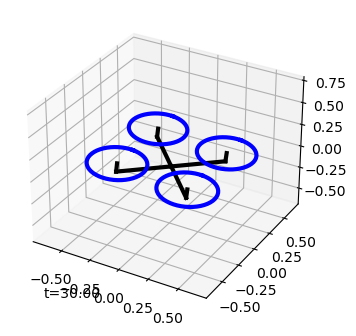

In [6]:
# Make a nice little gif of the quadrotor
a = quadrotoranimation.animate(log, fig=plt.figure(figsize=(4,4)), )
HTML(a.to_jshtml())
# a.save(folder + nametag + '.gif', fps=30)

# Plot the results of the simulation

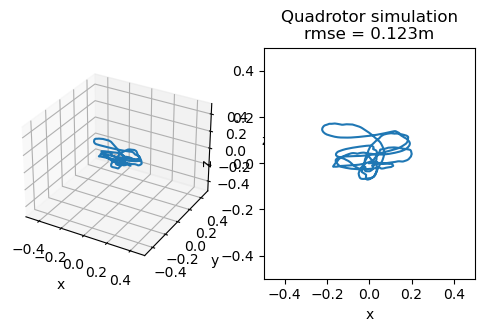

In [7]:
experiments.plot_3d(log, bound=0.5)

In [12]:
# You can plot any of these fields, as shown in the following cells
log.keys()

dict_keys(['y', 'mpddot', 'g', 'u', 'p_error', 'v_error', 'p_term', 'v_term', 'i_term', 'ad_term', 'g_term', 'f_hat', 'F_r_no_adaptive', 'pred_error', 'q_d', 'T_d', 'F_r', 'F_r_dot', 'F_r_prime', 's_oncone', 's_onsphere', 'meta_adapt_trigger', 'w_filtered_last', 'w', 'w_error_integral', 'w_filtered', 'w_filtered_derivative', 'alpha_sp', 'motor_speed_command', 'T', 'tau', 'alpha_', 'crossterm', 'Fs', 'tau_s', 'Vwind', 'process_noise', 'measurement_noise', 't', 'X', 'Xdot', 'Z', 'T_r', 'q_sp', 'w_sp', 'pd', 'vd', 'ad', 'p', 'q', 'v'])

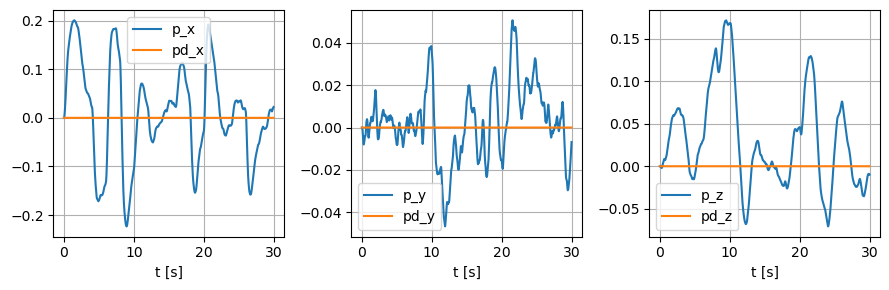

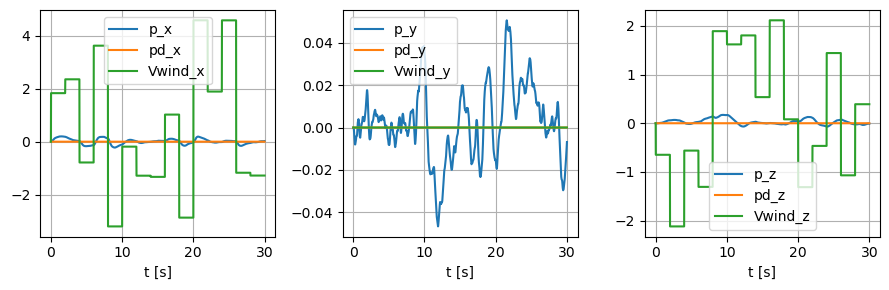

In [13]:
fig, axs = experiments.plot_fields(log, fields=['p', 'pd'], savename=folder + nametag + 'p-pd.png')
fig, axs = experiments.plot_fields(log, fields=['p', 'pd', 'Vwind'])

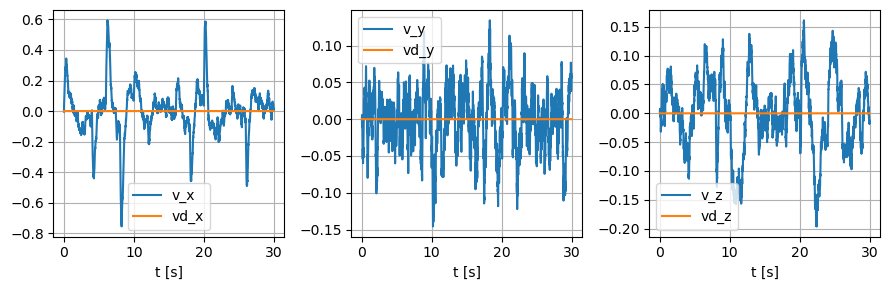

In [9]:
fig, axs = experiments.plot_fields(log, fields=['v', 'vd'])

(<Figure size 1200x300 with 4 Axes>,
 array([<AxesSubplot:xlabel='t [s]'>, <AxesSubplot:xlabel='t [s]'>,
        <AxesSubplot:xlabel='t [s]'>, <AxesSubplot:xlabel='t [s]'>],
       dtype=object))

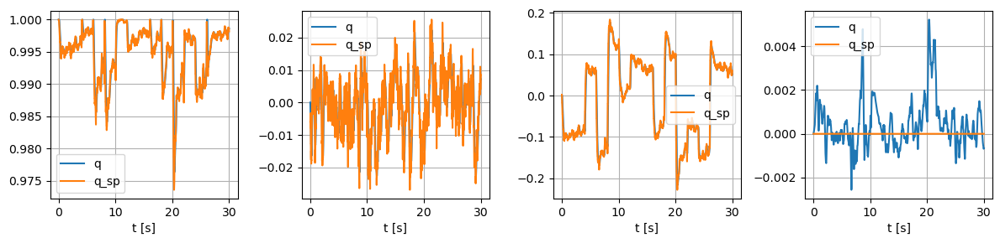

In [10]:
experiments.plot_fields(log, fields=['q', 'q_sp'])
# Notice that we plot q_sp, not q_d here. *_d is the * computed along 
# the desired trajectory for the nominal dynamics, that is without
# accounting for the learned dynamics. *_sp is the set point or
# commanded *. So in this case, the attitude controller is tracking
# q_sp, not q_d, as q_sp is computed to compensate for the learned 
# dynamics.

(<Figure size 900x300 with 3 Axes>,
 array([<AxesSubplot:xlabel='t [s]'>, <AxesSubplot:xlabel='t [s]'>,
        <AxesSubplot:xlabel='t [s]'>], dtype=object))

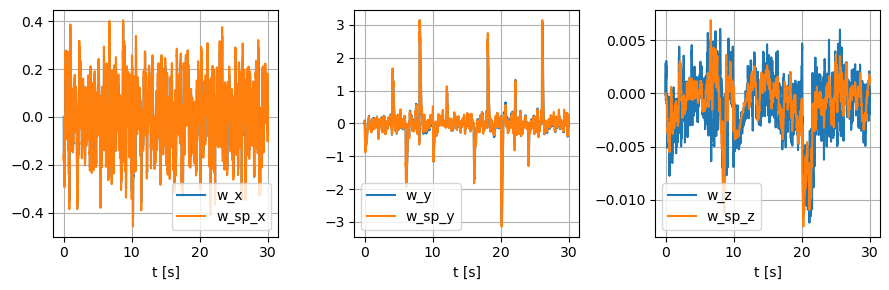

In [11]:
experiments.plot_fields(log, fields=['w', 'w_sp'])